In [2]:
import json
from pathlib import Path
import pandas as pd
import numpy as np

In [3]:
import seaborn as sns
import matplotlib.pyplot as plt

In [4]:
# Load the dataset from CSV
file_path = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/clean_dataset.csv'
df = pd.read_csv(file_path)


In [3]:
#showing top 5 rows in dataframe df

df.head()

,filename,asin,name,quantity,weight,height,length,width
0,06933.jpg,NaN,Moroso 74299 Mini Starter Heat Shield,2,0.250000,2.000000,13.900000,8.500000
1,07621.jpg,NaN,Dunecraft Carol Cactus Science Kit; O'Neill me...,3,0.100000,0.766667,0.933333,0.933333
2,115619.jpg,NaN,ALEX Toys Craft Knot A Quilt Kit; Wellness COR...,4,4.125139,3.371260,13.895866,11.540157
3,106035.jpg,NaN,"Petmate Furbuster Pet Hair Collector, TEAL/PEA...",4,0.425000,1.300000,9.000000,5.300000
4,104008.jpg,NaN,"Wireless Charger,Itian&trade;Qi 3-coil Wireles...",1,0.700000,3.400000,9.000000,4.200000


In [4]:
#length of dataframe

len(df)

10000

In [5]:
# Check for any null values
print("\nNull Value Statistics:")
print(df.isnull().sum())


Null Value Statistics:
filename        0
asin        10000
name            0
quantity        0
weight          0
height          0
length          0
width           0
dtype: int64


In [6]:
#dropping null values as asin is not needed for analysis

df.drop('asin', axis=1, inplace=True)

In [7]:
# Verfication for any null values
print("\nNull Value Statistics:")
print(df.isnull().sum())


Null Value Statistics:
filename    0
name        0
quantity    0
weight      0
height      0
length      0
width       0
dtype: int64


In [8]:
# Check for duplicate rows
duplicate_rows = df.duplicated()
print("\nNumber of duplicate rows:", duplicate_rows.sum())



Number of duplicate rows: 0


In [9]:
# Define the range of quantities you want to count
quantities_of_interest = range(6)  # This covers 0, 1, 2, 3, 4, 5

# Count occurrences of each quantity in the dataset
quantity_counts = df['quantity'].value_counts()

# Create a dictionary to hold counts for all quantities of interest, initializing with 0
quantity_summary = {qty: 0 for qty in quantities_of_interest}

# Update the dictionary with actual counts from the data
for qty in quantities_of_interest:
    if qty in quantity_counts:
        quantity_summary[qty] = quantity_counts[qty]

# Print the count for each quantity from 0 to 5
print("Counts of quantities from 0 to 5:")
for qty, count in quantity_summary.items():
    print(f"Quantity {qty}: {count}")


Counts of quantities from 0 to 5:
Quantity 0: 385
Quantity 1: 1615
Quantity 2: 2000
Quantity 3: 2000
Quantity 4: 2000
Quantity 5: 2000


In [10]:
# Get unique values from the 'quantity' column
unique_quantities = df['quantity'].unique()

# Sort the values for better readability
unique_quantities_sorted = sorted(unique_quantities)

# Print the unique values
print("Unique values in the 'quantity' column:")
print(unique_quantities_sorted)


Unique values in the 'quantity' column:
[0, 1, 2, 3, 4, 5]


In [11]:
print(df.head())

     filename                                               name  quantity  \
0   06933.jpg              Moroso 74299 Mini Starter Heat Shield         2   
1   07621.jpg  Dunecraft Carol Cactus Science Kit; O'Neill me...         3   
2  115619.jpg  ALEX Toys Craft Knot A Quilt Kit; Wellness COR...         4   
3  106035.jpg  Petmate Furbuster Pet Hair Collector, TEAL/PEA...         4   
4  104008.jpg  Wireless Charger,Itian&trade;Qi 3-coil Wireles...         1   

     weight    height     length      width  
0  0.250000  2.000000  13.900000   8.500000  
1  0.100000  0.766667   0.933333   0.933333  
2  4.125139  3.371260  13.895866  11.540157  
3  0.425000  1.300000   9.000000   5.300000  
4  0.700000  3.400000   9.000000   4.200000  


In [12]:
#filename consistency check to verify images and JSON in chosen 10000 samples

import os

# Assuming your DataFrame is named df and is already loaded
# Paths to your directories
image_dir = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/images10000'
json_dir = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/JSON10000'

# Check for missing image and JSON files
missing_images = []
missing_jsons = []

for filename in df['filename']:
    if not os.path.exists(os.path.join(image_dir, filename)):
        missing_images.append(filename)
    json_filename = filename.replace('.jpg', '.json')  # Assuming JSON files are named similarly but with .json extension
    if not os.path.exists(os.path.join(json_dir, json_filename)):
        missing_jsons.append(json_filename)

# Output results
if missing_images:
    print("Missing Image Files:", missing_images)
else:
    print("No missing image files.")

if missing_jsons:
    print("Missing JSON Files:", missing_jsons)
else:
    print("No missing JSON files.")


No missing image files.
No missing JSON files.


In [13]:
from PIL import Image
import os

# List to store the names of corrupted images
corrupted_images = []

# Loop through each filename in the DataFrame's 'filename' column
for filename in df['filename']:
    # Construct the full path to the image file
    filepath = os.path.join(image_dir, filename)
    try:
        # Attempt to open the image file
        img = Image.open(filepath)
        img.verify()  # Perform an additional verification to check if the image is corrupted
    except (IOError, SyntaxError) as e:
        # If an exception is caught, it means the image is corrupted
        corrupted_images.append(filename)

# Check if the list of corrupted images is empty
if corrupted_images:
    # If there are corrupted images, print their filenames
    print("Corrupted Image Files:", corrupted_images)
else:
    # If there are no corrupted images, print a confirmation message
    print("No corrupted image files.")


No corrupted image files.


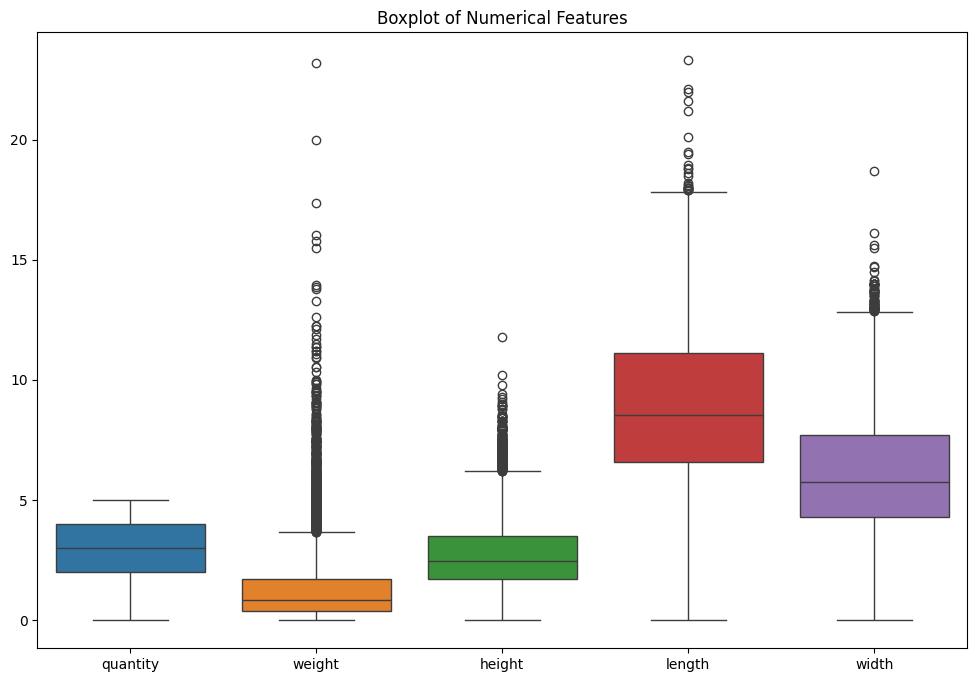

(287, 942)

In [15]:
#Calculating and plotting outliers to check noise in the dataframe

# Calculating Z-scores of the data
z_scores = np.abs((df.select_dtypes(include=[np.number]) - df.select_dtypes(include=[np.number]).mean()) / df.select_dtypes(include=[np.number]).std())

# Filtering outliers based on Z-score
outliers_z = (z_scores > 3).any(axis=1)

# Calculating IQR for each column
Q1 = df.select_dtypes(include=[np.number]).quantile(0.25)
Q3 = df.select_dtypes(include=[np.number]).quantile(0.75)
IQR = Q3 - Q1

# Filtering outliers based on IQR
outliers_iqr = ((df.select_dtypes(include=[np.number]) < (Q1 - 1.5 * IQR)) | (df.select_dtypes(include=[np.number]) > (Q3 + 1.5 * IQR))).any(axis=1)

# Plotting boxplots for each numerical feature to visualize outliers
plt.figure(figsize=(12, 8))
sns.boxplot(data=df.select_dtypes(include=[np.number]))
plt.title('Boxplot of Numerical Features')
plt.show()

# Returning the number of outliers detected by each method
outliers_z.sum(), outliers_iqr.sum()

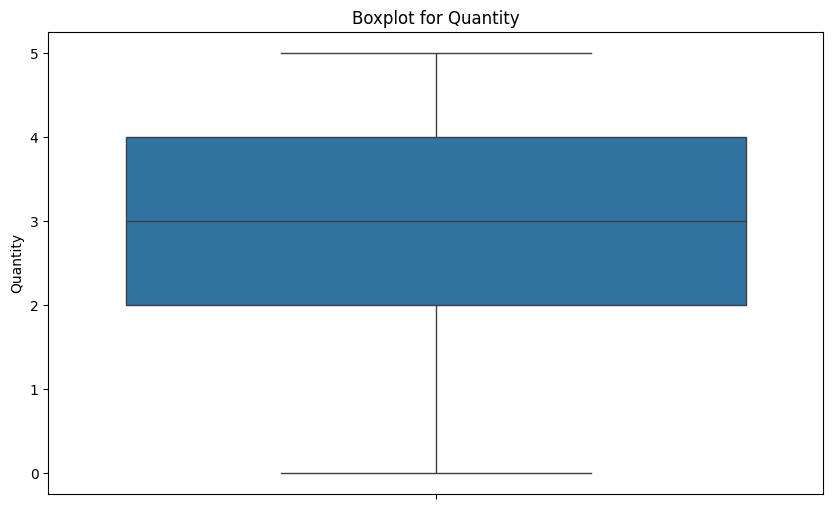

In [16]:
# Creating the box plot for the 'quantity' column
plt.figure(figsize=(10, 6))
sns.boxplot(data=df['quantity'])
plt.title('Boxplot for Quantity')
plt.ylabel('Quantity')
plt.show()

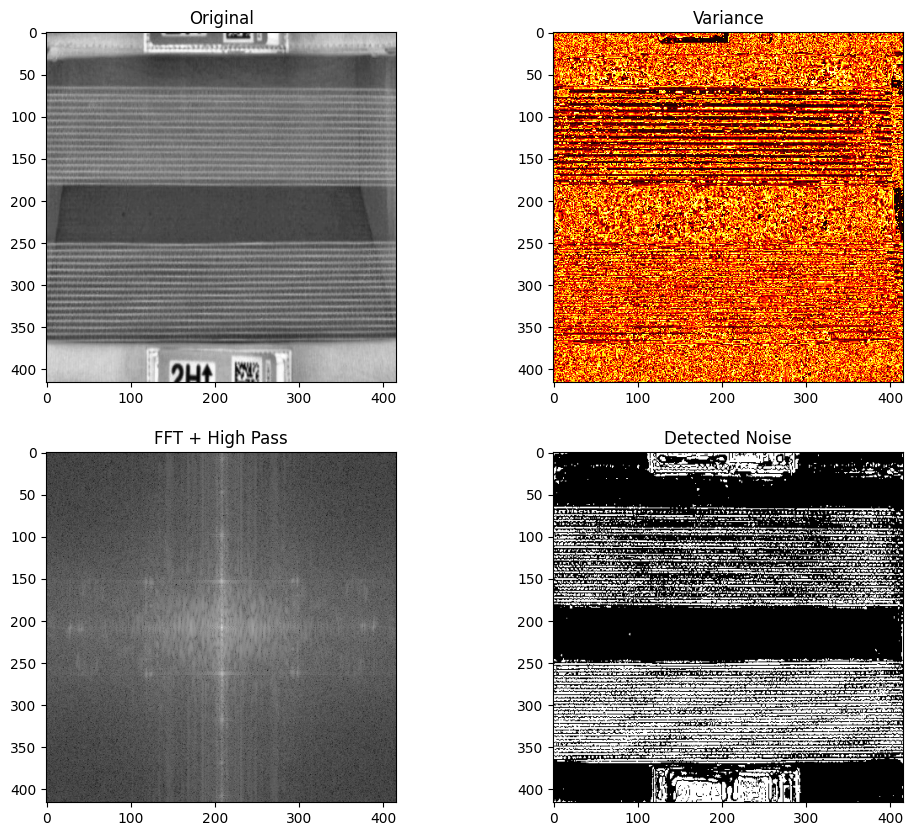

109.jpg: Estimated noise level: 112.05670418823965, Count of high frequency noise pixels: 59032


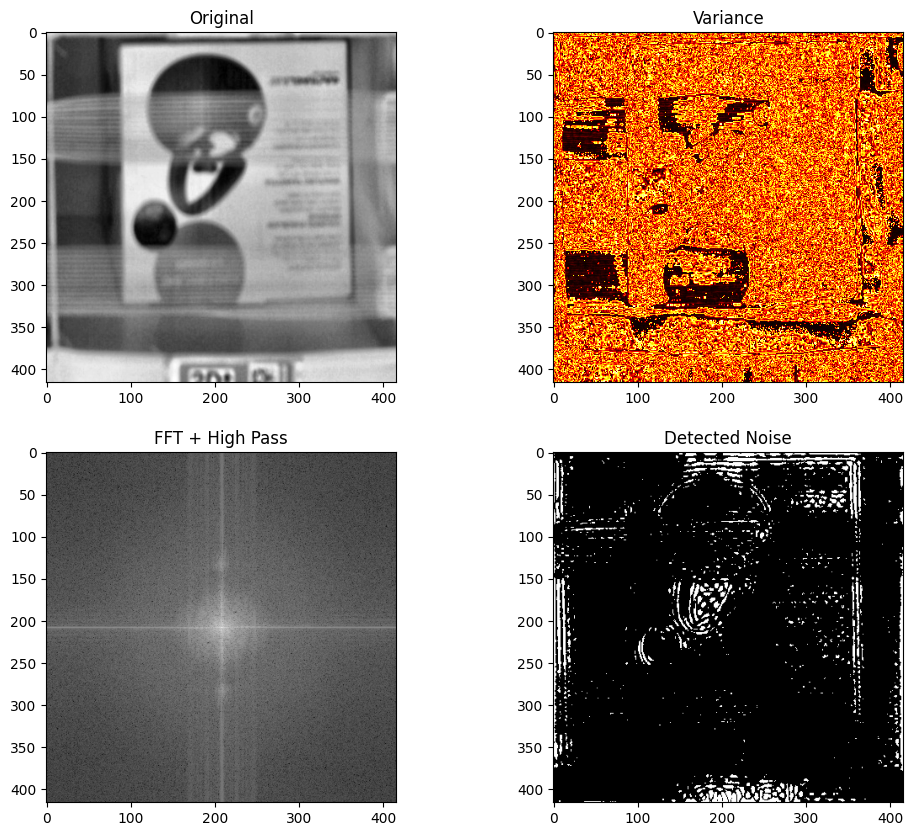

102456.jpg: Estimated noise level: 116.39703910872781, Count of high frequency noise pixels: 12830


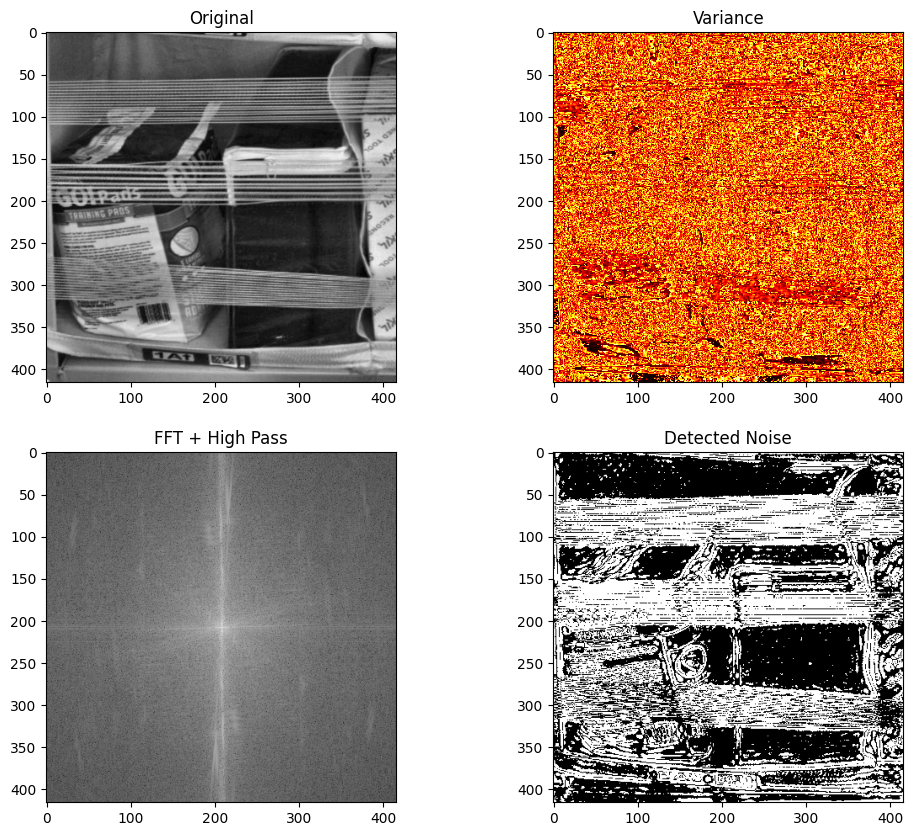

102733.jpg: Estimated noise level: 122.19831152921597, Count of high frequency noise pixels: 86033


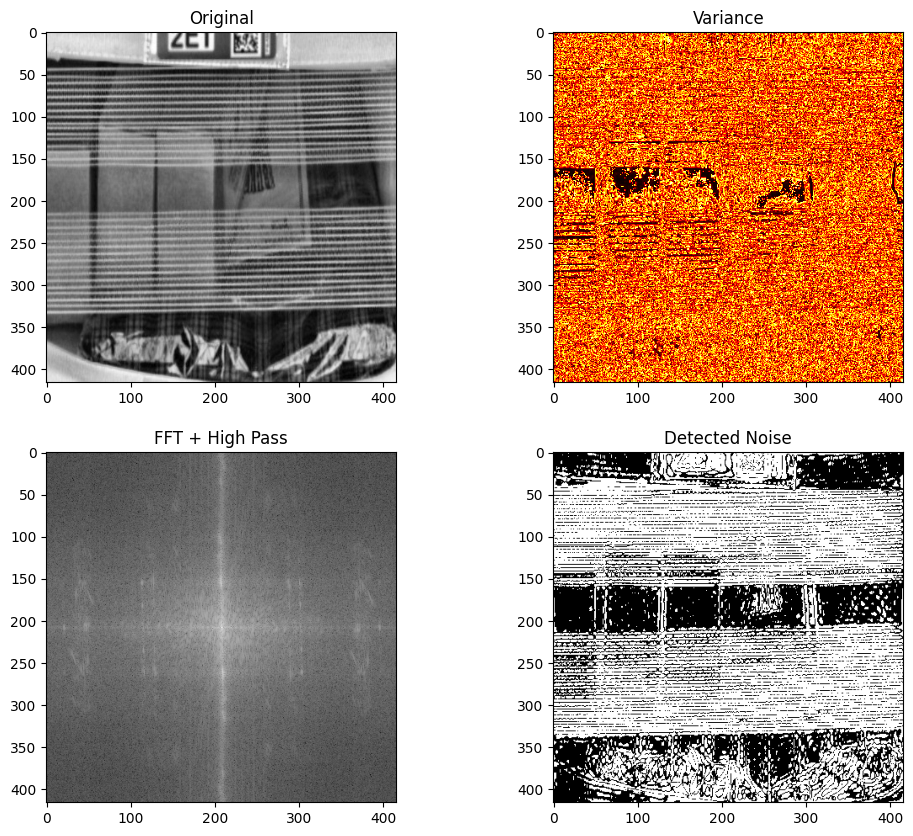

12028.jpg: Estimated noise level: 120.97049509985207, Count of high frequency noise pixels: 106246


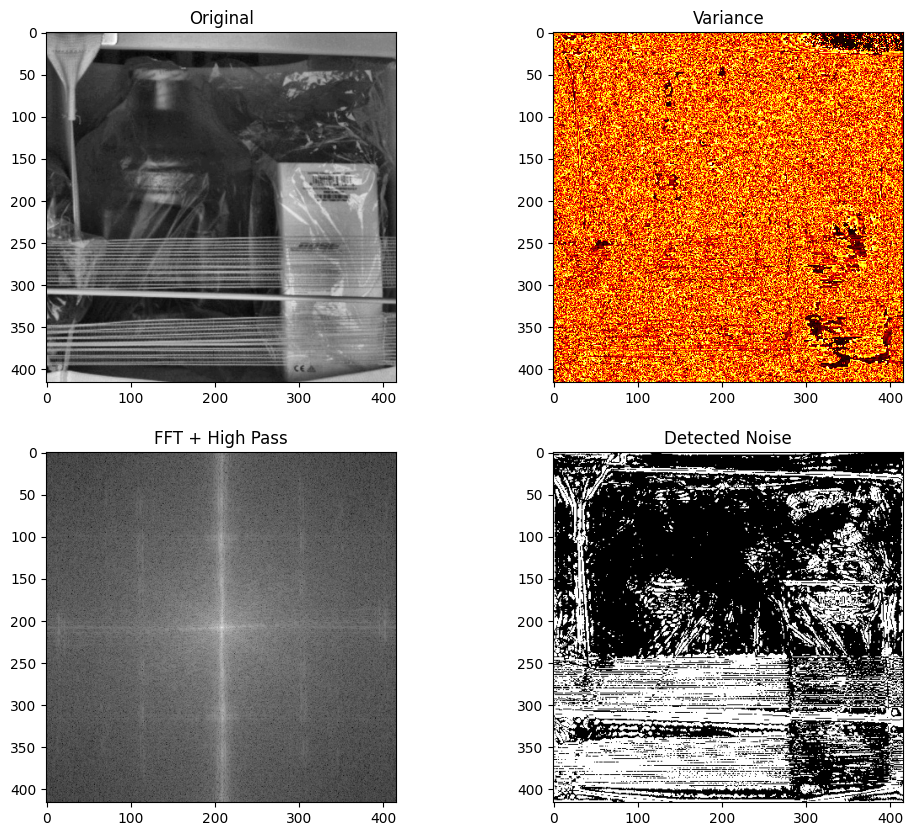

107090.jpg: Estimated noise level: 124.27151904585799, Count of high frequency noise pixels: 67455


In [22]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os

# The path to your image directory
image_dir = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/resized_images'

def calculate_noise(image):
    """Calculate the variance of the image and apply a high-pass filter to detect noise."""
    # Convert image to grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Calculate the local variance
    mean = cv2.blur(gray_image, (3, 3))
    mean_sq = cv2.blur(np.square(gray_image), (3, 3))
    variance = mean_sq - np.square(mean)
    
    # High-pass filter to enhance high-frequency components
    f = np.fft.fft2(gray_image)
    fshift = np.fft.fftshift(f)
    magnitude_spectrum = 20*np.log(np.abs(fshift))
    
    # Create a high pass filter mask
    rows, cols = gray_image.shape
    crow, ccol = rows//2 , cols//2
    mask = np.ones((rows, cols), np.uint8)
    r = 30  # radius of the low frequencies we want to remove
    center = [crow, ccol]
    x, y = np.ogrid[:rows, :cols]
    mask_area = (x - center[0]) ** 2 + (y - center[1]) ** 2 <= r*r
    mask[mask_area] = 0

    # Apply mask and inverse DFT
    fshift = fshift * mask
    f_ishift = np.fft.ifftshift(fshift)
    img_back = np.fft.ifft2(f_ishift)
    img_back = np.abs(img_back)

    # Threshold to binary image, high values are potential noise pixels
    _, thresh = cv2.threshold(img_back, 11, 255, cv2.THRESH_BINARY)

    # Plotting for one example
    plt.figure(figsize=(12, 10))
    plt.subplot(221), plt.imshow(gray_image, cmap='gray'), plt.title('Original')
    plt.subplot(222), plt.imshow(variance, cmap='hot'), plt.title('Variance')
    plt.subplot(223), plt.imshow(magnitude_spectrum, cmap='gray'), plt.title('FFT + High Pass')
    plt.subplot(224), plt.imshow(thresh, cmap='gray'), plt.title('Detected Noise')
    plt.show()

    return np.mean(variance), np.sum(thresh > 0)

# Process a subset of images for noise detection
for filename in df['filename'].sample(5).tolist():  # Using a sample of 5 for demonstration
    image_path = os.path.join(image_dir, filename)
    if os.path.exists(image_path):
        image = cv2.imread(image_path)
        noise_level, count_noise_pixels = calculate_noise(image)
        print(f"{filename}: Estimated noise level: {noise_level}, Count of high frequency noise pixels: {count_noise_pixels}")
    else:
        print(f"{filename} does not exist in the directory.")


In [32]:
#bilateral filtering to remove noise by keeping edges sharp--applied on proccessed images with CLAHE, LOG and resized 

import cv2
import os

# Define the directory containing the images
original_image_dir = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/processed_images'
# Define the directory to save the noise-reduced images
noise_removed_dir = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/noise_removed'

# Create the directory for noise-reduced images if it does not exist
if not os.path.exists(noise_removed_dir):
    os.makedirs(noise_removed_dir)

# Get a list of image filenames
image_files = [f for f in os.listdir(original_image_dir) if f.endswith('.jpg') or f.endswith('.png')]

# Define the batch size
batch_size = 100  

for i in range(0, len(image_files), batch_size):
    batch_files = image_files[i:i + batch_size]
    print(f"Processing batch {i // batch_size + 1}")

    for filename in batch_files:
        # Read the color image
        image_path = os.path.join(original_image_dir, filename)
        image = cv2.imread(image_path)

        # Apply bilateral filter to the color image
        filtered_image = cv2.bilateralFilter(image, d=9, sigmaColor=75, sigmaSpace=75)

        # Define the path for saving the noise-reduced image
        save_path = os.path.join(noise_removed_dir, filename)

        # Save the noise-reduced image
        cv2.imwrite(save_path, filtered_image)

    print(f"Completed batch {i // batch_size + 1}")

print("All batches processed successfully.")


Processing batch 1
Completed batch 1
Processing batch 2
Completed batch 2
Processing batch 3
Completed batch 3
Processing batch 4
Completed batch 4
Processing batch 5
Completed batch 5
Processing batch 6
Completed batch 6
Processing batch 7
Completed batch 7
Processing batch 8
Completed batch 8
Processing batch 9
Completed batch 9
Processing batch 10
Completed batch 10
Processing batch 11
Completed batch 11
Processing batch 12
Completed batch 12
Processing batch 13
Completed batch 13
Processing batch 14
Completed batch 14
Processing batch 15
Completed batch 15
Processing batch 16
Completed batch 16
Processing batch 17
Completed batch 17
Processing batch 18
Completed batch 18
Processing batch 19
Completed batch 19
Processing batch 20
Completed batch 20
Processing batch 21
Completed batch 21
Processing batch 22
Completed batch 22
Processing batch 23
Completed batch 23
Processing batch 24
Completed batch 24
Processing batch 25
Completed batch 25
Processing batch 26
Completed batch 26
Proc

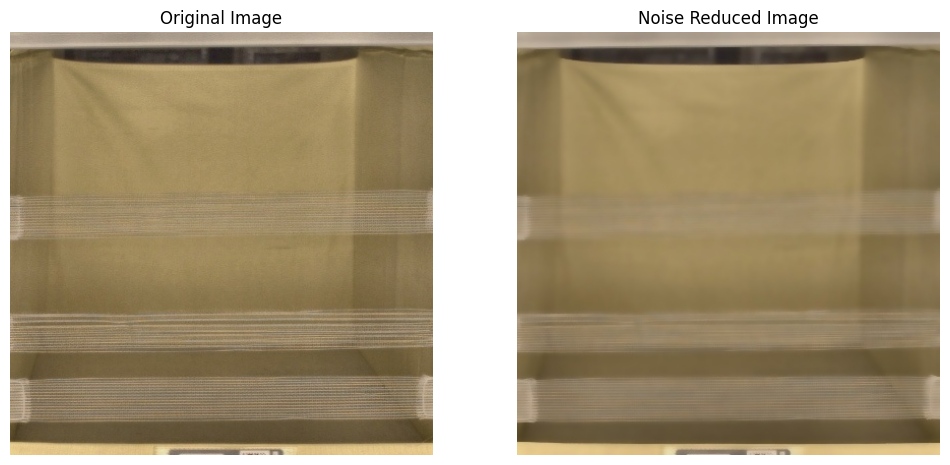

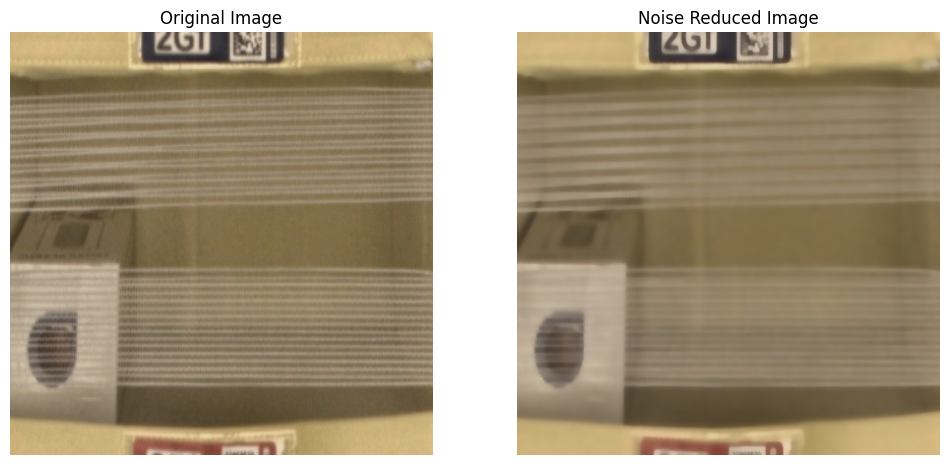

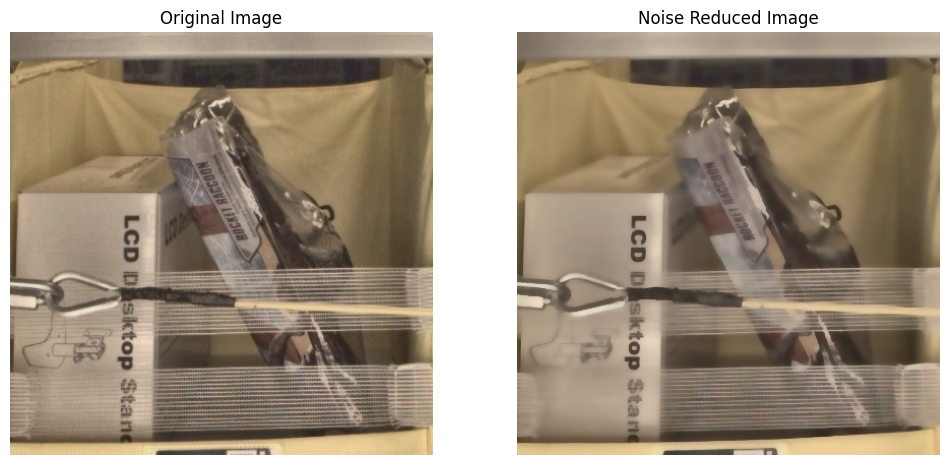

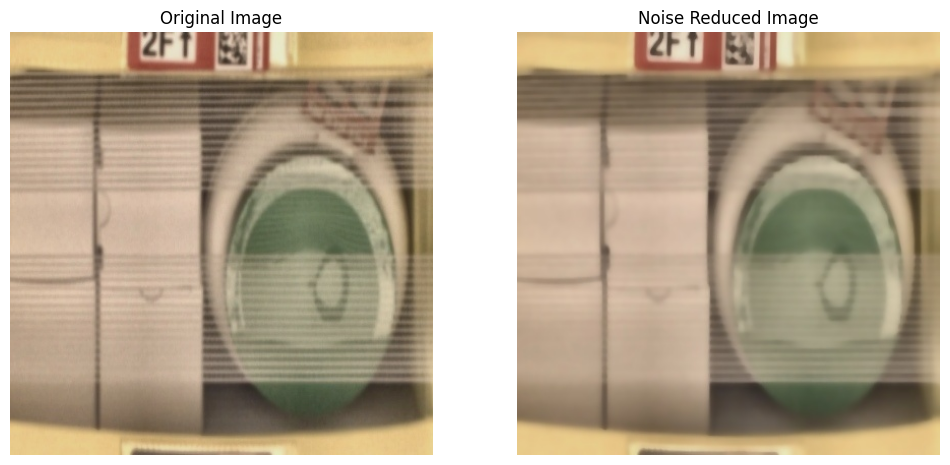

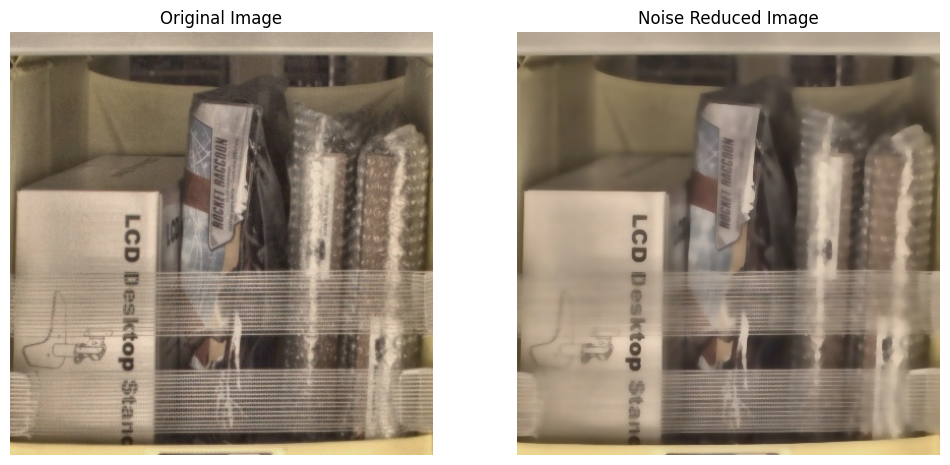

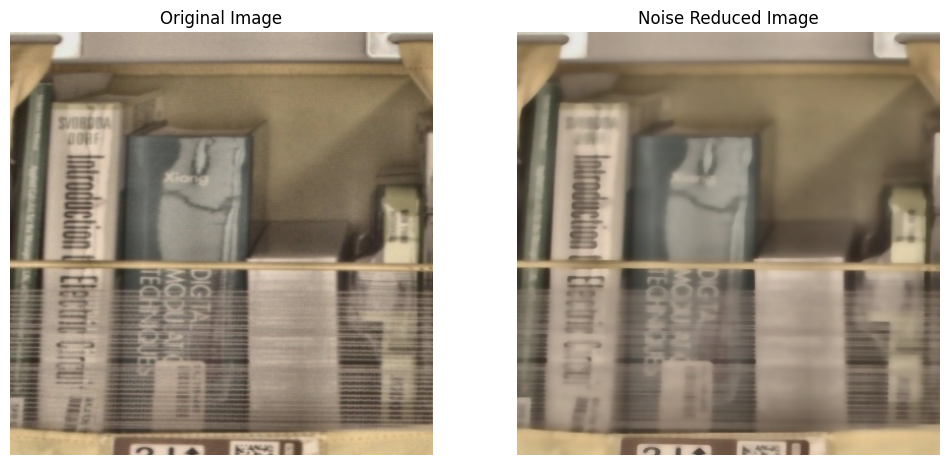

In [33]:
#to compare before and after filtering data


import cv2
from matplotlib import pyplot as plt
import os

# Define the directories
original_image_dir = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/processed_images'
noise_removed_dir = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/noise_removed'

# List of filenames you want to compare
filenames = [
    '100.jpg',
    '00594.jpg',
    '00054.jpg',
    '1069.jpg',
    '00055.jpg',
    '00537.jpg'
]

# Loop through the specified filenames
for filename in filenames:
    # Paths for the original and noise-reduced images
    original_path = os.path.join(original_image_dir, filename)
    noise_reduced_path = os.path.join(noise_removed_dir, filename)

    # Load the images
    original_image = cv2.imread(original_path)
    noise_reduced_image = cv2.imread(noise_reduced_path)

    # Convert from BGR to RGB for display
    original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
    noise_reduced_image = cv2.cvtColor(noise_reduced_image, cv2.COLOR_BGR2RGB)

    # Display the images
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.imshow(original_image)
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(noise_reduced_image)
    plt.title('Noise Reduced Image')
    plt.axis('off')

    # Show the plot
    plt.show()


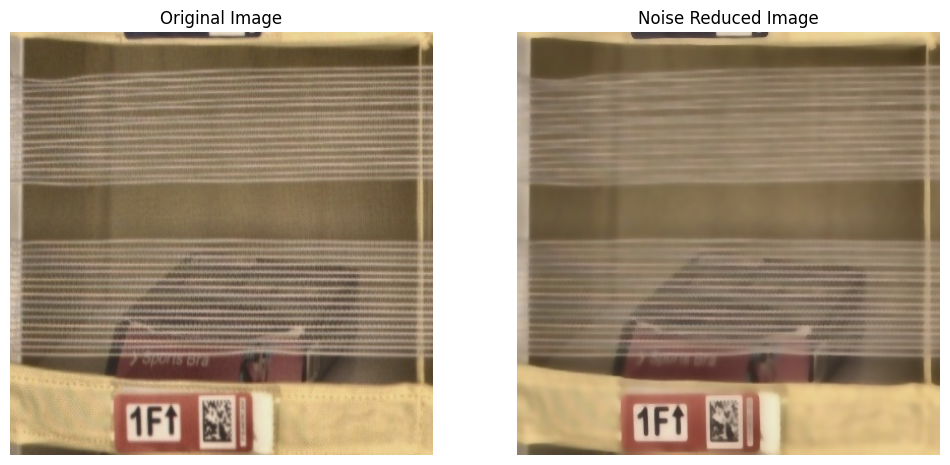

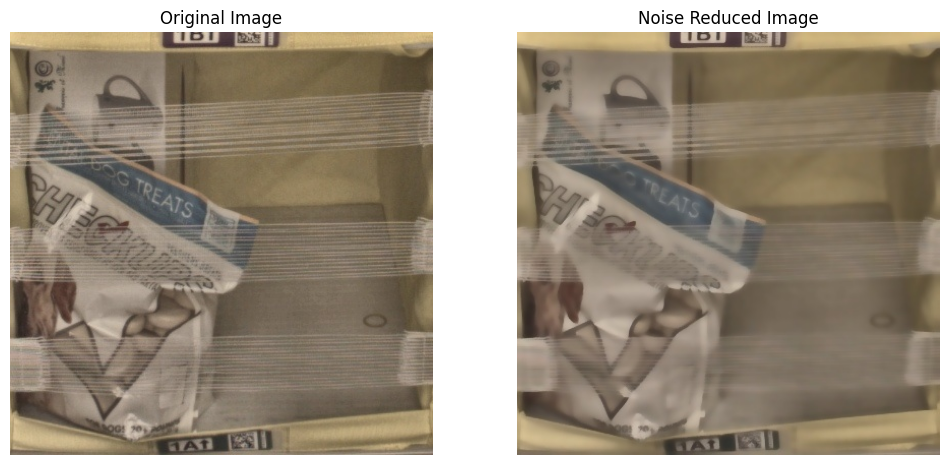

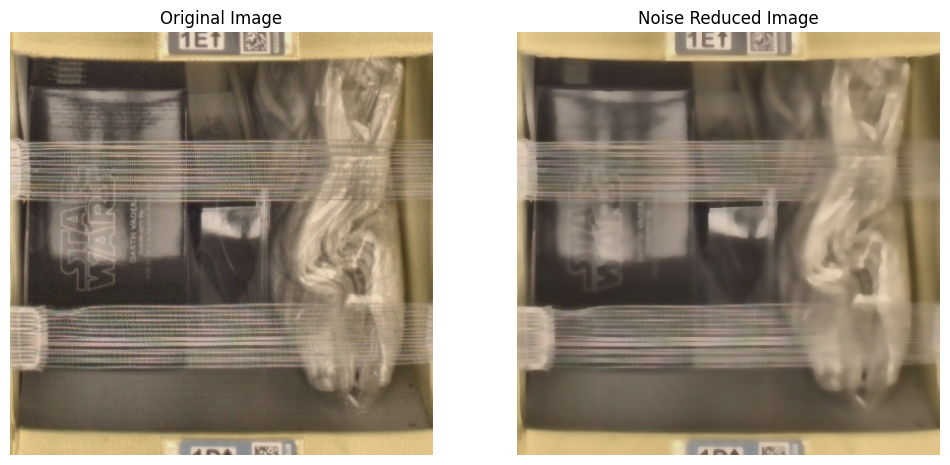

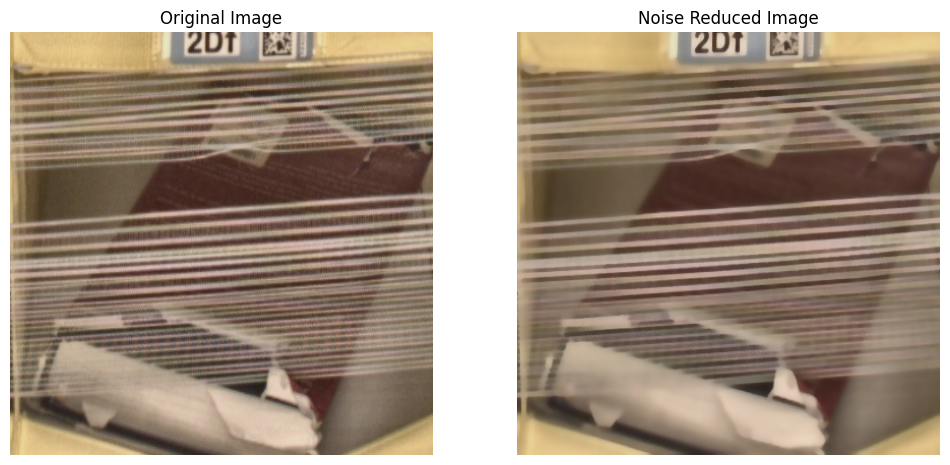

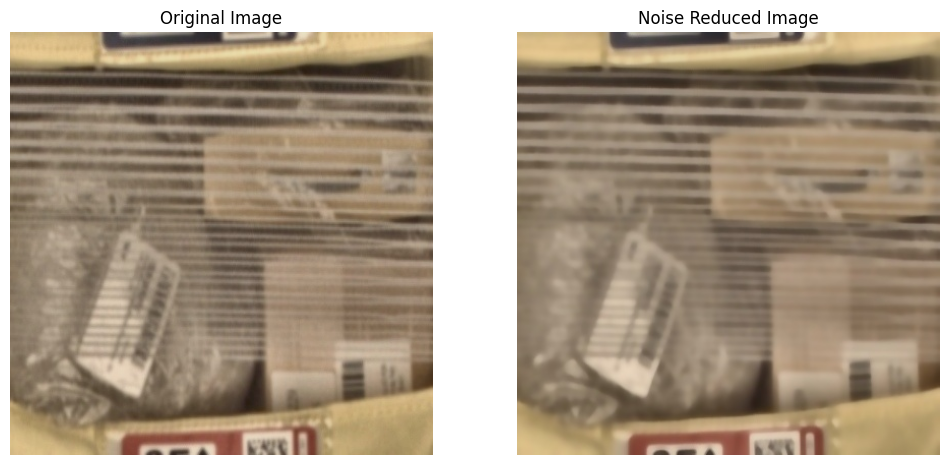

In [34]:
import cv2
import os
import matplotlib.pyplot as plt
import random

# Define the directories
original_image_dir = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/processed_images'
noise_removed_dir = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/noise_removed'

# Get all image filenames in the original directory
all_files = [f for f in os.listdir(noise_removed_dir) if f.endswith('.jpg') or f.endswith('.png')]

# Randomly select a subset of files
selected_files = random.sample(all_files, 5)  # Change number here based on how many you want to review

# Loop through the selected filenames
for filename in selected_files:
    # Paths for the original and noise-reduced images
    original_path = os.path.join(original_image_dir, filename)
    noise_reduced_path = os.path.join(noise_removed_dir, filename)

    # Load the images
    original_image = cv2.imread(original_path)
    noise_reduced_image = cv2.imread(noise_reduced_path)

    # Convert from BGR to RGB for display
    original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
    noise_reduced_image = cv2.cvtColor(noise_reduced_image, cv2.COLOR_BGR2RGB)

    # Display the images
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.imshow(original_image)
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(noise_reduced_image)
    plt.title('Noise Reduced Image')
    plt.axis('off')

    # Show the plot
    plt.show()


Handling of Inconsistent Data - in dataframe df

In [35]:
#checking and converting the data formats

# Convert the 'name' column to lowercase
df['name'] = df['name'].str.lower()

In [36]:
# Specify columns to round
float_columns = ['weight', 'height', 'length', 'width']  # Add or remove columns as needed
df[float_columns] = df[float_columns].round(2)

# Print the DataFrame to verify the changes
print(df)


        filename                                               name  quantity  \
0      06933.jpg              moroso 74299 mini starter heat shield         2   
1      07621.jpg  dunecraft carol cactus science kit; o'neill me...         3   
2     115619.jpg  alex toys craft knot a quilt kit; wellness cor...         4   
3     106035.jpg  petmate furbuster pet hair collector, teal/pea...         4   
4     104008.jpg  wireless charger,itian&trade;qi 3-coil wireles...         1   
...          ...                                                ...       ...   
9995  114963.jpg  disney planes: fire & rescue oversized windlif...         1   
9996   04966.jpg  pop secret movie theater butter popcorn, 28 co...         1   
9997  104060.jpg            swimline 15030r - sunsoft mattress, red         1   
9998  115364.jpg  pack of 1 wix filters - 57173 cartridge lube m...         1   
9999  109347.jpg  sunwarrior - classic protein, raw wholegrain b...         1   

      weight  height  lengt

In [37]:
# Check for a consistent pattern, e.g., all filenames are numeric followed by .jpg
# Here, we use a regular expression to check for this pattern.
pattern_match = df['filename'].str.match(r'^\d+\.jpg$').all()
print(f"All filenames match the numeric pattern: {pattern_match}")

All filenames match the numeric pattern: True


In [39]:
import cv2
import os

# Function to get unique resolutions of images in a directory
def get_unique_resolutions(directory):
    resolutions = set()  # A set to store unique resolutions
    for filename in os.listdir(directory):
        if filename.endswith('.jpg'):  # Check for .jpg files
            image_path = os.path.join(directory, filename)
            image = cv2.imread(image_path)
            if image is not None:
                resolutions.add(image.shape[:2])  # Add the resolution (height, width)
    return resolutions

# Directories containing the original and resized images
original_dir = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/images10000'
resized_dir = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/resized_images'

# Get unique resolutions
original_resolutions = get_unique_resolutions(original_dir)
resized_resolutions = get_unique_resolutions(resized_dir)

# Display the unique resolutions
print(f"Unique resolutions in the original images: {original_resolutions}")



Unique resolutions in the original images: {(471, 637), (310, 454), (412, 322), (605, 637), (329, 553), (423, 331), (255, 375), (677, 513), (355, 462), (697, 720), (321, 469), (347, 378), (252, 369), (472, 638), (413, 323), (330, 554), (424, 332), (629, 701), (282, 477), (556, 488), (359, 468), (266, 389), (325, 475), (366, 476), (680, 523), (940, 599), (269, 394), (283, 478), (369, 481), (650, 500), (286, 483), (486, 657), (661, 509), (640, 715), (681, 524), (586, 515), (270, 395), (370, 482), (297, 498), (662, 510), (914, 582), (606, 466), (284, 415), (530, 556), (301, 504), (515, 576), (371, 419), (985, 727), (456, 526), (579, 453), (583, 603), (542, 422), (553, 580), (967, 714), (318, 534), (1041, 663), (397, 449), (504, 395), (503, 579), (316, 344), (535, 419), (620, 606), (319, 349), (505, 396), (551, 363), (524, 409), (570, 376), (322, 540), (336, 438), (516, 405), (320, 350), (372, 626), (347, 453), (486, 382), (430, 338), (316, 465), (476, 454), (487, 463), (621, 692), (408, 3

In [40]:
print(f"Unique resolutions in the resized images: {resized_resolutions}")

Unique resolutions in the resized images: {(416, 416)}


Filename: 106577.jpg, Quantity: 1
Filename: 06617.jpg, Quantity: 3
Filename: 01845.jpg, Quantity: 1
Filename: 03376.jpg, Quantity: 3
Filename: 03425.jpg, Quantity: 5


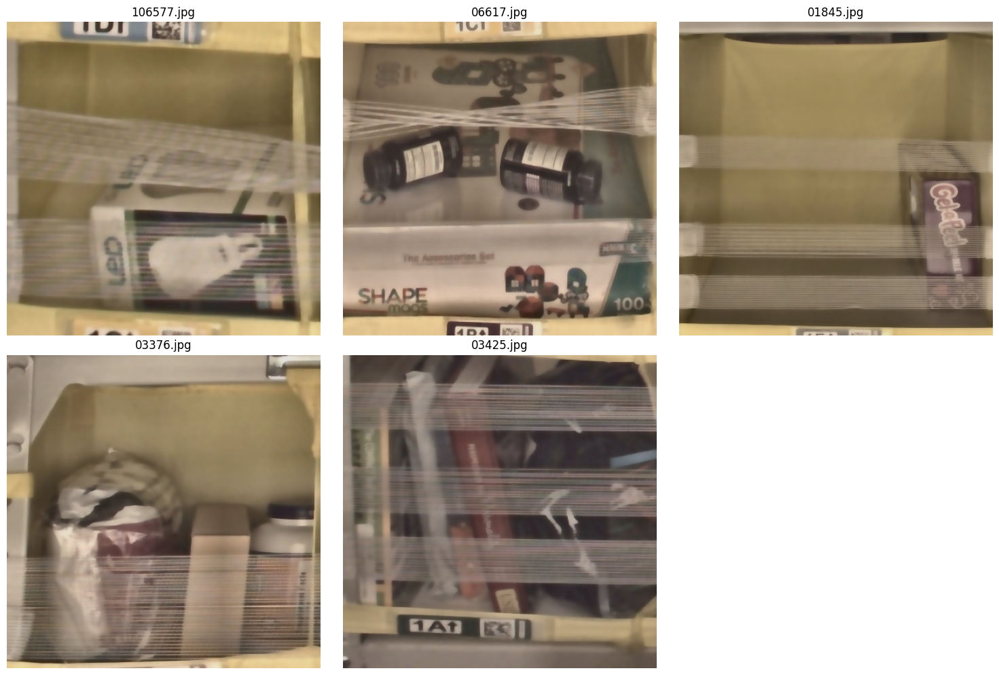

In [70]:
#To randomly select images and quantiy for manual inspection

import os
import random
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Path to the directory with images
image_dir = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/noise_removed'


# List all .jpg files in the directory
file_list = [f for f in os.listdir(image_dir) if f.endswith('.jpg')]
selected_files = random.sample(file_list, 5)  # Randomly select 5 images

# Display the selected images and print corresponding 'quantity' values
plt.figure(figsize=(15, 10))  # Larger figure size for better visibility
for i, filename in enumerate(selected_files):
    # Read and display the image
    img_path = os.path.join(image_dir, filename)
    img = mpimg.imread(img_path)
    plt.subplot(2, 3, i + 1)  # Adjust subplot params to display images in 2 rows
    plt.imshow(img)
    plt.title(filename)
    plt.axis('off')

    # Print the quantity associated with the image
    if filename in df['filename'].values:
        quantity = df.loc[df['filename'] == filename, 'quantity'].values[0]
        print(f"Filename: {filename}, Quantity: {quantity}")
    else:
        print(f"Filename: {filename} not found in DataFrame.")

plt.tight_layout()
plt.show()

Exploratory Data Analysis

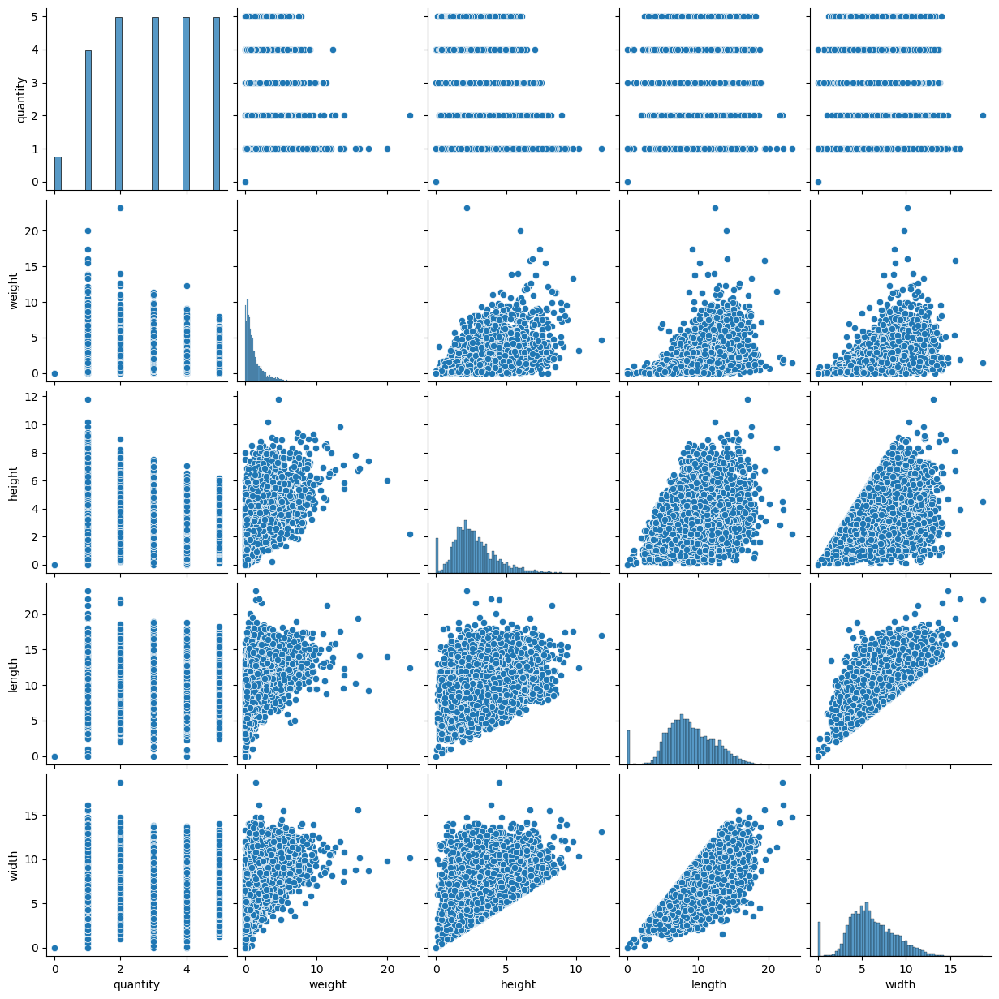

In [71]:
# Pair plot for all numerical features
sns.pairplot(df[['quantity', 'weight', 'height', 'length', 'width']])
plt.show()

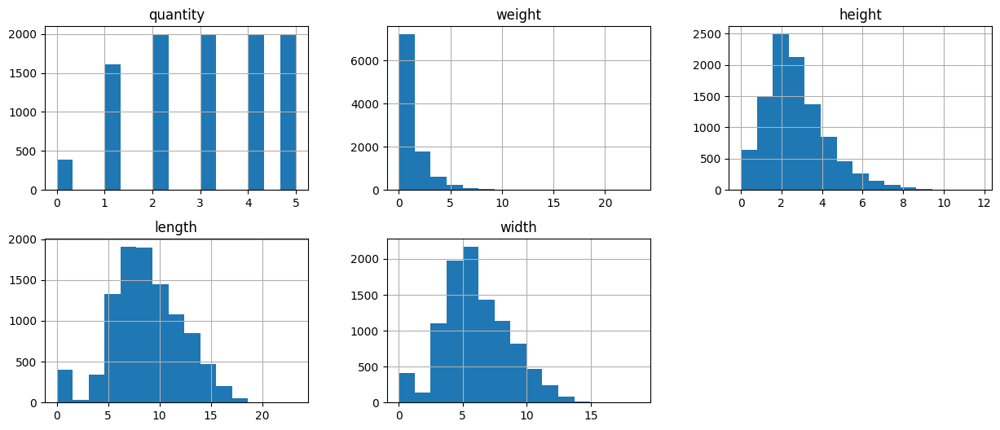

In [72]:
# Histograms for each numerical feature
df[['quantity', 'weight', 'height', 'length', 'width']].hist(bins=15, figsize=(15, 6), layout=(2, 3))
plt.show()

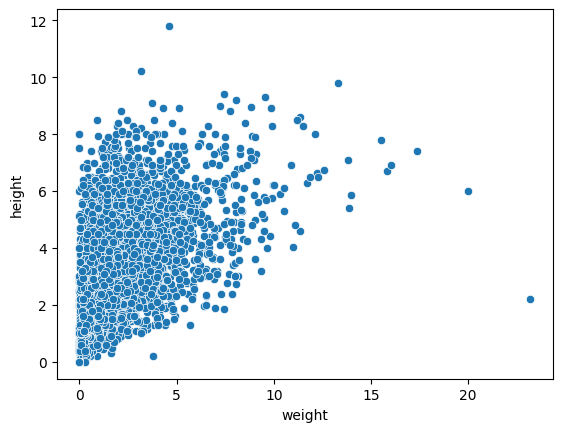

In [73]:
# Scatter plots for pairs of variables
sns.scatterplot(data=df, x='weight', y='height')
plt.show()


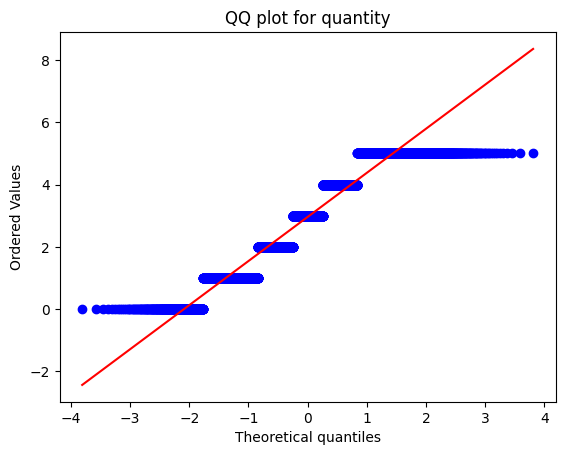

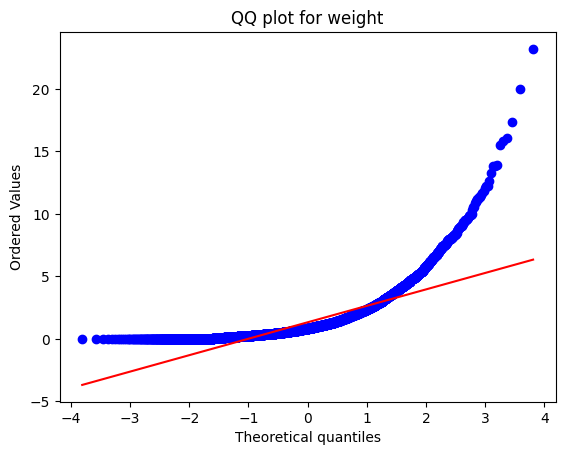

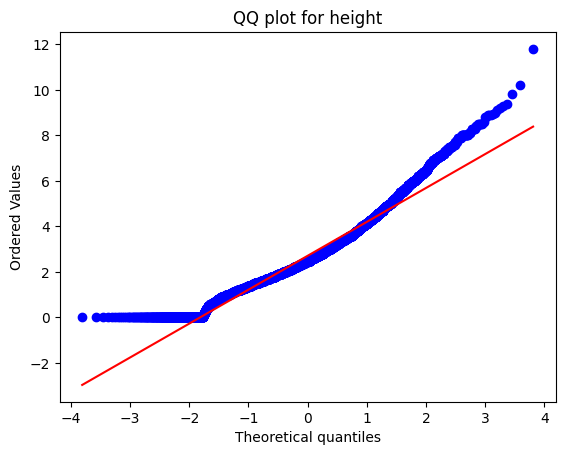

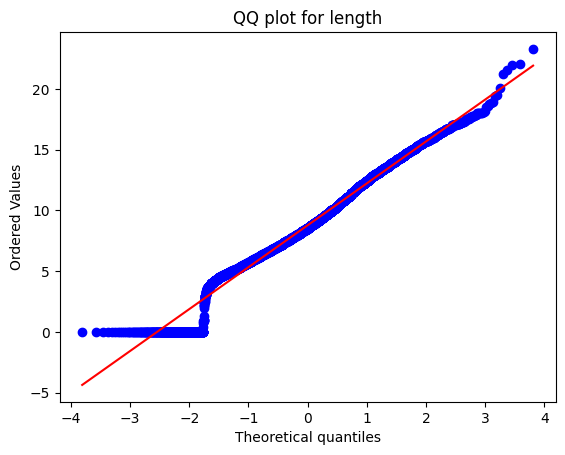

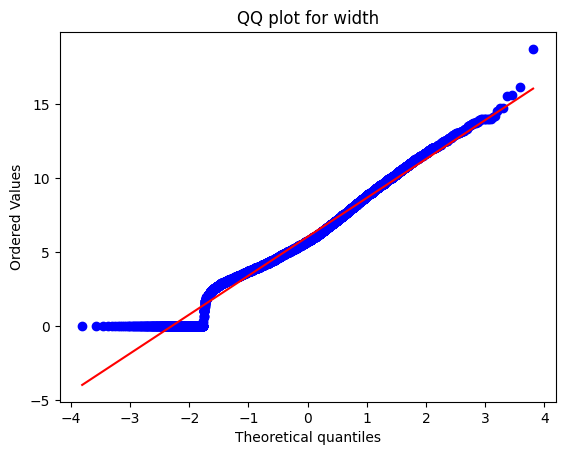

In [75]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

# QQ plots for checking normality
for column in ['quantity', 'weight', 'height', 'length', 'width']:
    plt.figure()
    stats.probplot(df[column], dist="norm", plot=plt)
    plt.title(f'QQ plot for {column}')
    plt.show()


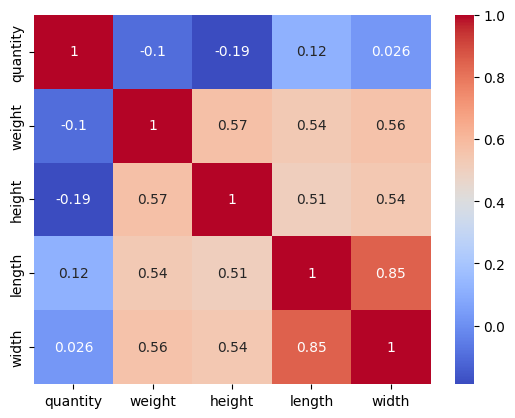

In [76]:
# Correlation matrix and heatmap
correlation_matrix = df[['quantity', 'weight', 'height', 'length', 'width']].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.show()

Data Transformation

CLAHE image preprocessing before and after images

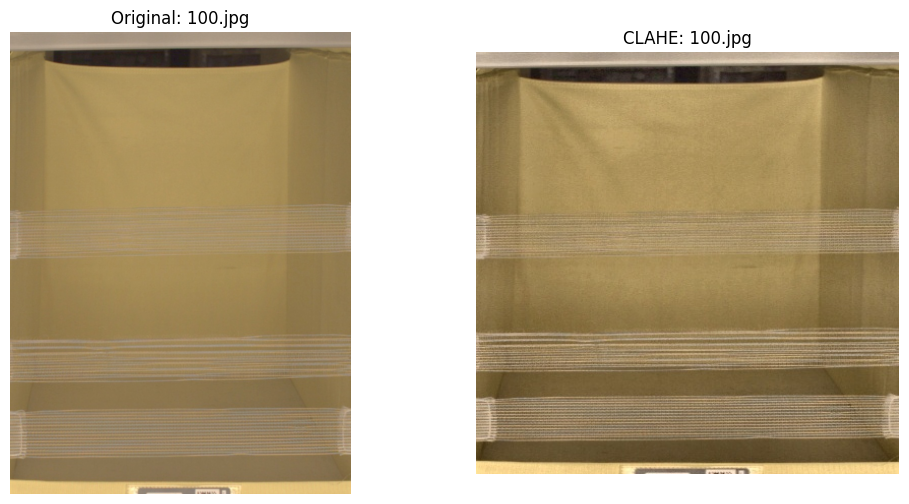

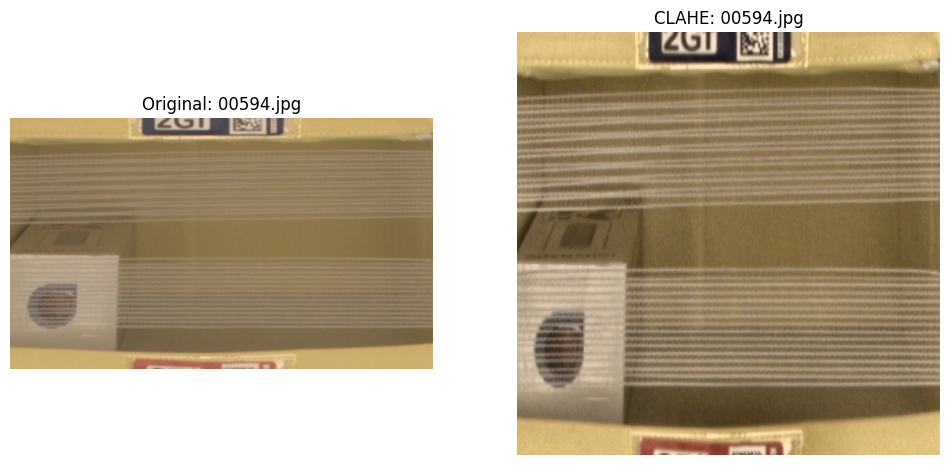

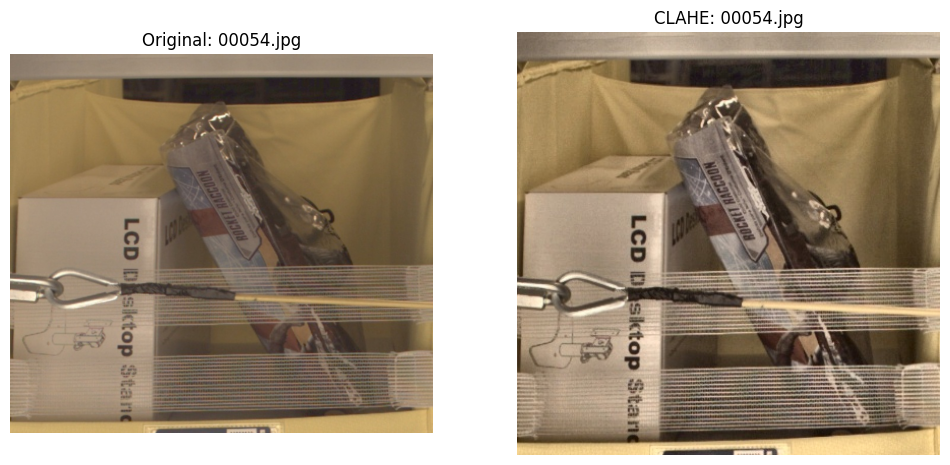

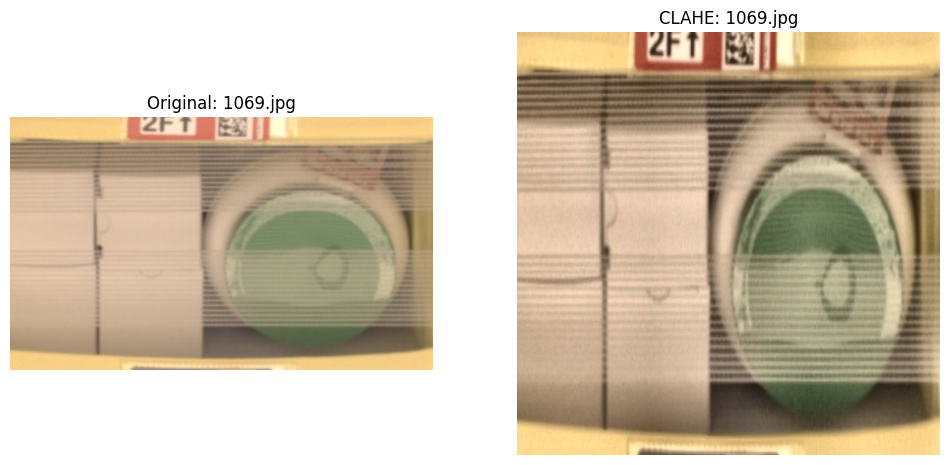

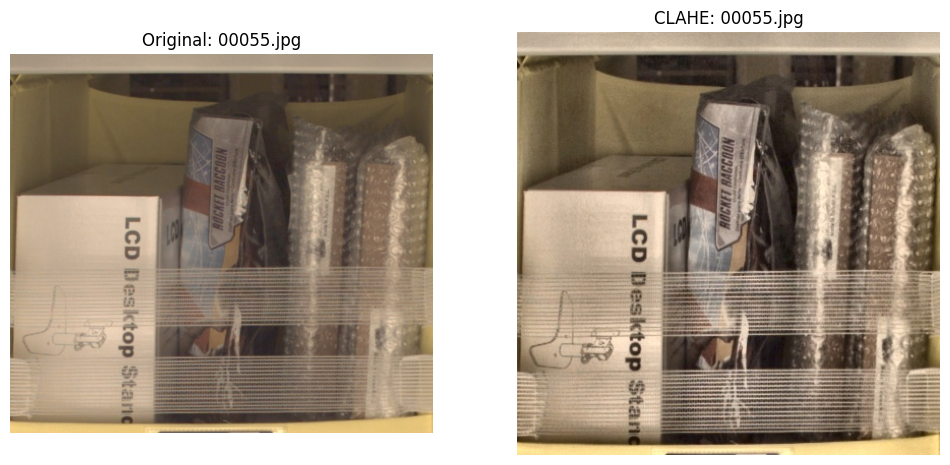

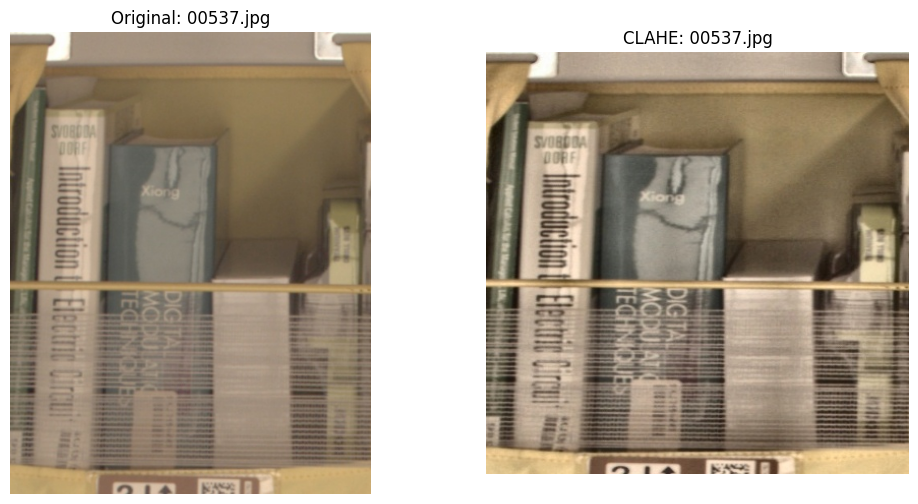

In [79]:
import cv2
import os
import matplotlib.pyplot as plt

# Define the directories
original_image_dir = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/images10000'
clahe_image_dir = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/resized_images'

# List of filenames for the images you want to display
filenames = [
    '100.jpg',
    '00594.jpg',
    '00054.jpg',
    '1069.jpg',
    '00055.jpg',
    '00537.jpg'
]

# Loop through the filenames and display the original and CLAHE images
for filename in filenames:
    # Paths for the original and CLAHE images
    original_path = os.path.join(original_image_dir, filename)
    clahe_path = os.path.join(clahe_image_dir, filename)

    # Load the images
    original_image = cv2.imread(original_path)
    clahe_image = cv2.imread(clahe_path)

    # Convert from BGR to RGB for display
    original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
    clahe_image = cv2.cvtColor(clahe_image, cv2.COLOR_BGR2RGB)

    # Display the images
    plt.figure(figsize=(12, 6))  # You can adjust the figure size as needed

    plt.subplot(1, 2, 1)
    plt.imshow(original_image)
    plt.title(f'Original: {filename}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(clahe_image)
    plt.title(f'CLAHE: {filename}')
    plt.axis('off')

    # Show the plot
    plt.show()


Laplacian of Gaussian for image preprocessing- before and after images

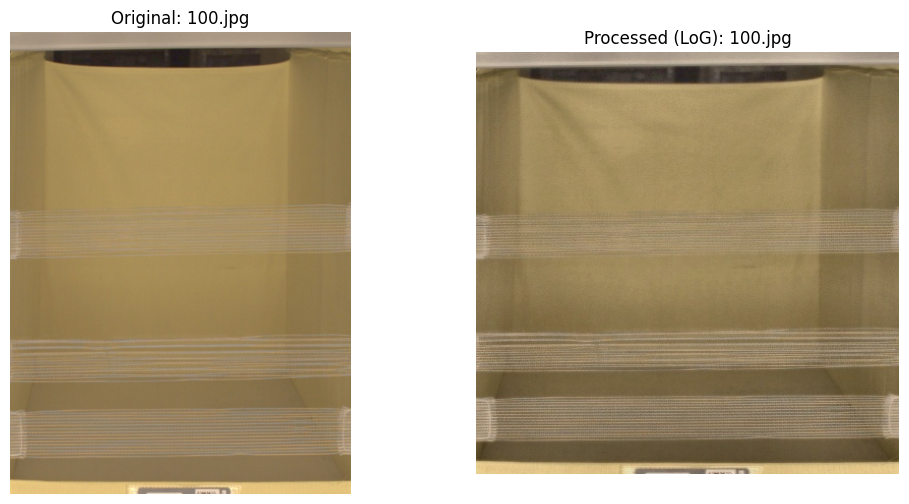

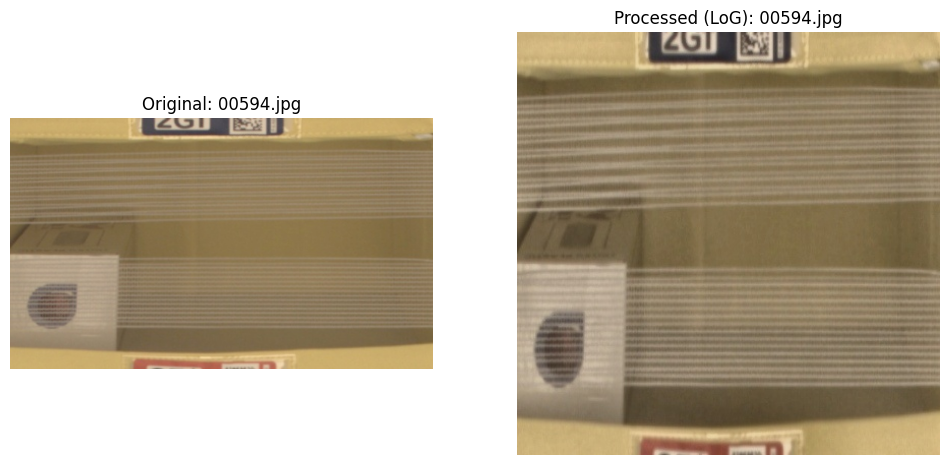

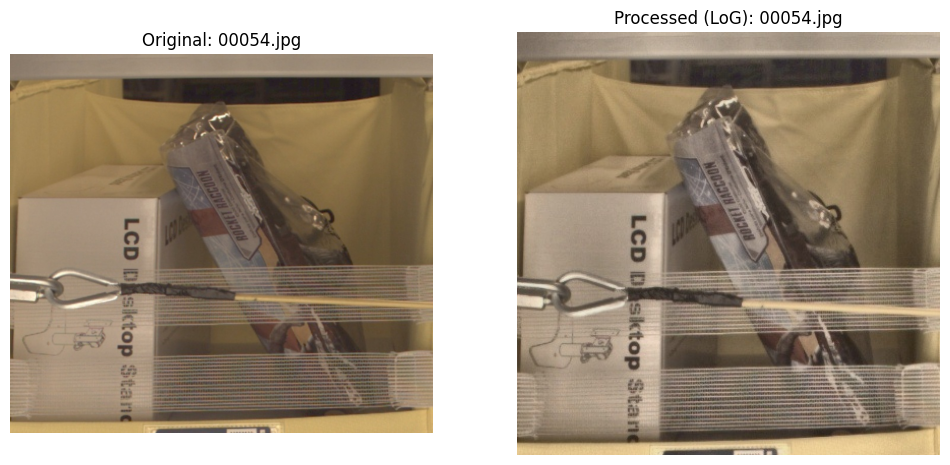

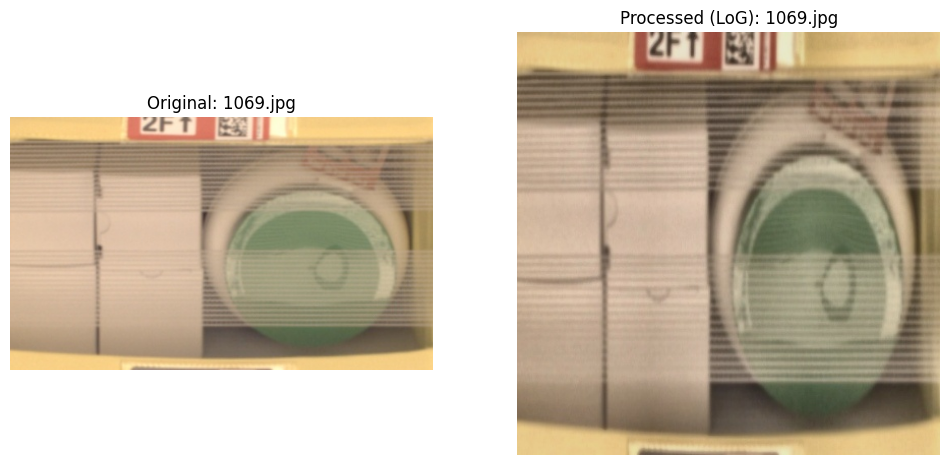

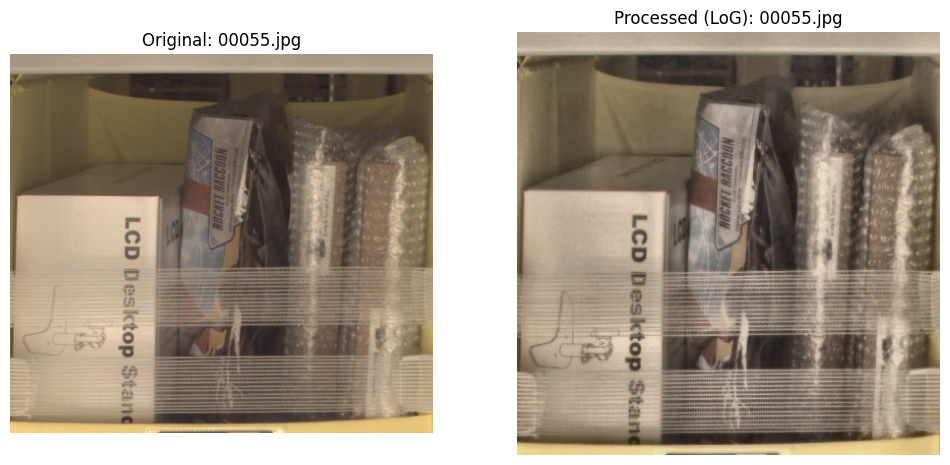

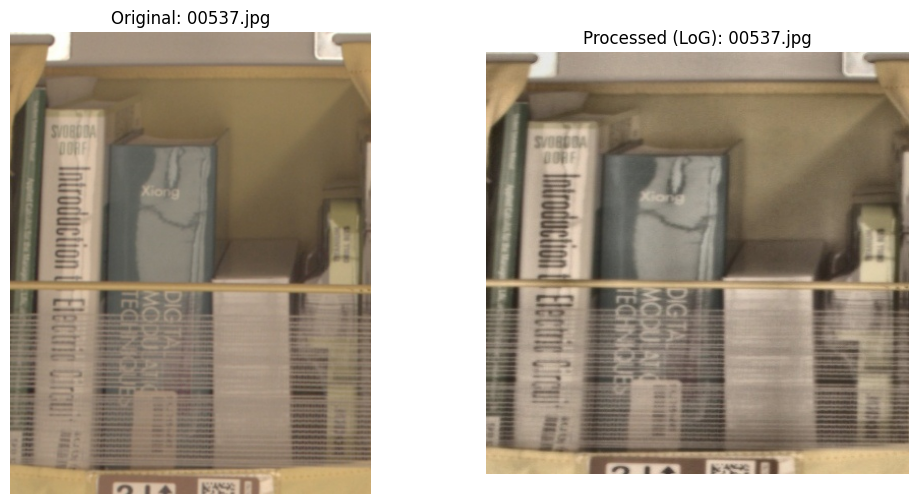

In [80]:
import cv2
import os
import matplotlib.pyplot as plt

# Define the directories for the original and Laplacian of Gaussian processed images
original_image_dir = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/images10000'
processed_image_dir = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/processed_images'

# List of filenames for the images you want to display
filenames = [
    '100.jpg',
    '00594.jpg',
    '00054.jpg',
    '1069.jpg',
    '00055.jpg',
    '00537.jpg'
]

# Loop through the filenames and display the original and processed images
for filename in filenames:
    # Paths for the original and processed images
    original_path = os.path.join(original_image_dir, filename)
    processed_path = os.path.join(processed_image_dir, filename)

    # Load the images
    original_image = cv2.imread(original_path)
    processed_image = cv2.imread(processed_path)

    # Convert from BGR to RGB for display purposes
    original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
    processed_image = cv2.cvtColor(processed_image, cv2.COLOR_BGR2RGB)

    # Display the images
    plt.figure(figsize=(12, 6))  # Adjust the figure size as needed

    plt.subplot(1, 2, 1)
    plt.imshow(original_image)
    plt.title(f'Original: {filename}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(processed_image)
    plt.title(f'Processed (LoG): {filename}')
    plt.axis('off')

    # Show the plot
    plt.show()


Data Regularization- checking both L1 and l2

Lasso Mean Squared Error: 1.9767647952628582
Ridge Mean Squared Error: 1.9602860783218776


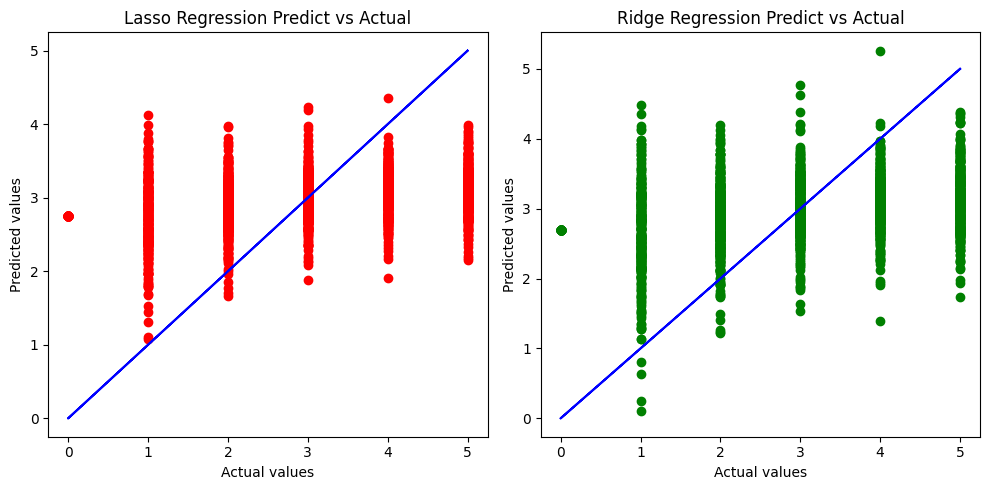

In [81]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Lasso, Ridge
from sklearn.metrics import mean_squared_error
import numpy as np
import matplotlib.pyplot as plt


# Define features and target
X = df[['weight', 'height', 'length', 'width']]
y = df['quantity']

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# L1 Regularization: Lasso
lasso = Lasso(alpha=0.1)
lasso.fit(X_train, y_train)
lasso_predictions = lasso.predict(X_test)
lasso_mse = mean_squared_error(y_test, lasso_predictions)
print(f"Lasso Mean Squared Error: {lasso_mse}")

# L2 Regularization: Ridge
ridge = Ridge(alpha=0.1)
ridge.fit(X_train, y_train)
ridge_predictions = ridge.predict(X_test)
ridge_mse = mean_squared_error(y_test, ridge_predictions)
print(f"Ridge Mean Squared Error: {ridge_mse}")

# Plotting the results
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.scatter(y_test, lasso_predictions, color='red')
plt.plot(y_test, y_test, color='blue')
plt.title('Lasso Regression Predict vs Actual')
plt.xlabel('Actual values')
plt.ylabel('Predicted values')

plt.subplot(1, 2, 2)
plt.scatter(y_test, ridge_predictions, color='green')
plt.plot(y_test, y_test, color='blue')
plt.title('Ridge Regression Predict vs Actual')
plt.xlabel('Actual values')
plt.ylabel('Predicted values')

plt.tight_layout()
plt.show()


PCA

In [10]:
import os
import numpy as np
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Lasso, Ridge
from sklearn.preprocessing import StandardScaler
import pandas as pd

# Directory containing images and path to the CSV file
dir_path = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/noise_removed'

# Function to load images and the corresponding quantity
def load_images_with_targets(directory, dataframe, sample_size=1000):
    image_data = []
    target_values = []
    loaded_filenames = dataframe['filename'].iloc[:sample_size].values  # Get the filenames for the sample_size
    for filename in loaded_filenames:
        if filename.endswith('.jpg'):  # Adjust the file extension as needed
            img_path = os.path.join(directory, filename)
            try:
                img = Image.open(img_path).convert('L')  # Convert image to grayscale
                img_array = np.array(img).flatten()  # Flatten image to 1D array
                image_data.append(img_array)
                # Assuming the order of records in the DataFrame matches the images
                target_values.append(dataframe[dataframe['filename'] == filename]['quantity'].iloc[0])
            except FileNotFoundError:
                print(f"File {filename} not found in the directory.")
    return np.array(image_data), np.array(target_values)

# Load image data and corresponding target values
image_data, target_values = load_images_with_targets(dir_path, df)

# Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(image_data)

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X_scaled, target_values, test_size=0.2, random_state=42)

# Apply L1 Regularization (Lasso) Regression
lasso_reg = Lasso(alpha=0.1, max_iter=10000)  # Increased max_iter
lasso_reg.fit(X_train, y_train)

# Apply L2 Regularization (Ridge) Regression
ridge_reg = Ridge(alpha=0.1)
ridge_reg.fit(X_train, y_train)

# Evaluate the models
lasso_score = lasso_reg.score(X_test, y_test)
ridge_score = ridge_reg.score(X_test, y_test)

# Print out the scores
print(f'Lasso Regression Score: {lasso_score}')
print(f'Ridge Regression Score: {ridge_score}')


Lasso Regression Score: 0.02481686206582101
Ridge Regression Score: -0.8948827646068107


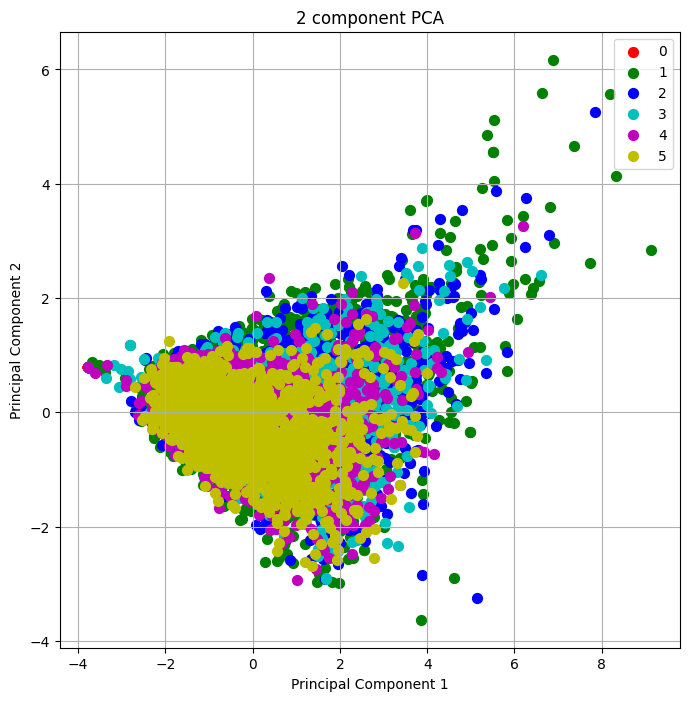

[0.69735482 0.15819627]


In [87]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Assuming df is your DataFrame

# Selecting numerical features
features = ['weight', 'height', 'length', 'width']
X = df.loc[:, features].values

# Standardizing the features
X = StandardScaler().fit_transform(X)

# PCA projection to 2D for visualization purposes
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(X)

# Creating a DataFrame with the principal components
principalDf = pd.DataFrame(data=principalComponents, columns=['Principal Component 1', 'Principal Component 2'])

# Concatenating the principal components with the target variable 'quantity'
finalDf = pd.concat([principalDf, df[['quantity']]], axis=1)

# Plotting the observations along the principal components
plt.figure(figsize=(8,8))
targets = np.unique(df['quantity'])
colors = ['r', 'g', 'b', 'c', 'm', 'y', 'k']

for target, color in zip(targets, colors):
    indicesToKeep = finalDf['quantity'] == target
    plt.scatter(finalDf.loc[indicesToKeep, 'Principal Component 1'],
                finalDf.loc[indicesToKeep, 'Principal Component 2'],
                c=color,
                s=50)

plt.title('2 component PCA')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(targets)
plt.grid()
plt.show()

# Explained variance ratio
print(pca.explained_variance_ratio_)


In [88]:


# PCA fitting
pca.fit(X)

# Print the components and the amount of variance they explain
print("PCA components (eigenvectors):\n", pca.components_)
print("Explained variance ratio:\n", pca.explained_variance_ratio_)

# Creating a DataFrame for better visualization of the PCA components
components_df = pd.DataFrame(pca.components_, columns=features, index=[f'Principal Component {i+1}' for i in range(pca.n_components_)])
print(components_df)


PCA components (eigenvectors):
 [[ 0.47172149  0.46064788  0.52689288  0.53634528]
 [ 0.47257548  0.58663914 -0.49381006 -0.43437146]]
Explained variance ratio:
 [0.69735482 0.15819627]
                         weight    height    length     width
Principal Component 1  0.471721  0.460648  0.526893  0.536345
Principal Component 2  0.472575  0.586639 -0.493810 -0.434371


Variance covered by the first component: 10.31%
Variance covered by the second component: 4.80%


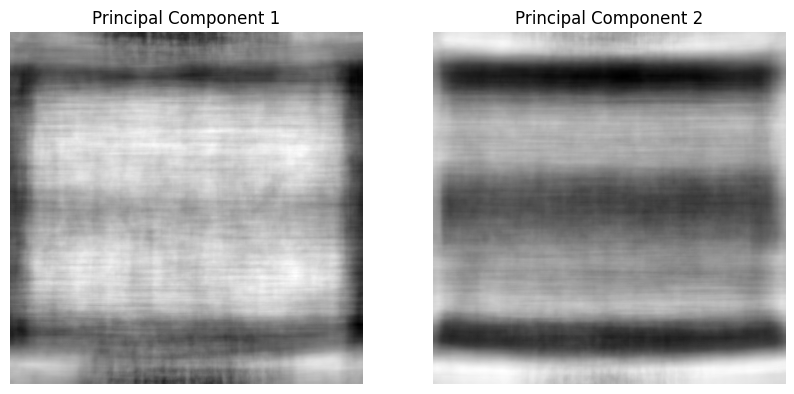

In [6]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

# Directory containing images
dir_path = '/Users/priyasuresh/Documents/Documents_Priya’s MacBook Pro/SPRING2024/Data 270- Data Analyst Process/Project_Data_preprocessing/noise_removed'

# Load image data
def load_images(directory, sample_size=1000):  # Let's limit the loading to a manageable number for demonstration
    images = []
    filenames = []
    for i, filename in enumerate(os.listdir(directory)):
        if filename.endswith('.jpg') and i < sample_size:  # Adjust the file extension as needed
            img_path = os.path.join(directory, filename)
            img = Image.open(img_path).convert('L')  # Convert image to grayscale
            img_array = np.array(img).flatten()
            images.append(img_array)
            filenames.append(filename)
        if i >= sample_size:
            break
    return np.array(images), filenames

image_data, image_filenames = load_images(dir_path)

# Apply K-means clustering to categorize images
n_clusters = 6  # Example: create 6 clusters, adjust based on your specific needs
kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(image_data)

# Get cluster assignments
clusters = kmeans.labels_

# Standardize the data
image_data_standardized = (image_data - np.mean(image_data, axis=0)) / np.std(image_data, axis=0)

# Apply PCA
pca = PCA(n_components=2)
principal_components = pca.fit_transform(image_data_standardized)

# Print the variance covered by the first two principal components
print("Variance covered by the first component: {:.2%}".format(pca.explained_variance_ratio_[0]))
print("Variance covered by the second component: {:.2%}".format(pca.explained_variance_ratio_[1]))

# Display the first two principal components as images
def display_components(components):
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    for i, ax in enumerate(axes):
        ax.imshow(components[i].reshape(416, 416), cmap='gray')
        ax.set_title(f'Principal Component {i+1}')
        ax.axis('off')
    plt.show()

display_components(pca.components_)


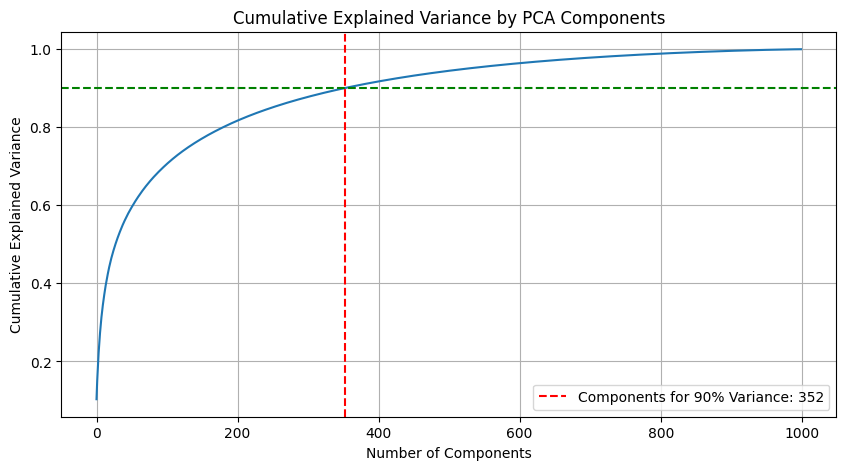

352

In [8]:
# Code to determine the number of components for 90% variance
# and to generate a scree plot.
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# Assume 'image_data_standardized' is the standardized image data.
pca_full = PCA()
pca_full.fit(image_data_standardized)

# Calculate the cumulative sum of explained variance ratios
cumulative_variance = np.cumsum(pca_full.explained_variance_ratio_)

# Determine how many components are required to get above 90% variance
n_components_90 = np.argmax(cumulative_variance >= 0.90) + 1  # +1 because index starts from 0

# Scree plot of the explained variance
plt.figure(figsize=(10, 5))
plt.plot(cumulative_variance)
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance by PCA Components')
plt.axvline(x=n_components_90, color='r', linestyle='--', label=f'Components for 90% Variance: {n_components_90}')
plt.axhline(y=0.90, color='g', linestyle='--')
plt.legend()
plt.grid(True)
plt.show()

n_components_90
